In [4]:
!pip install plotly

In [5]:
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Dense,Flatten,Conv2D,MaxPooling2D
from tensorflow.keras.layers  import Concatenate
from tensorflow.keras.layers import AveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import SGD
from sklearn.metrics import classification_report, confusion_matrix
from keras.layers import Input, Add, Dense,GlobalAvgPool2D, Concatenate, AvgPool2D, Dropout, ReLU, Activation, MaxPool2D, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, GlobalAveragePooling2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
import matplotlib.pyplot as plt # for ploting graph
import os
#-------------------------------------------------------------------------------
from tensorflow.keras.preprocessing.image import load_img, img_to_array, ImageDataGenerator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelBinarizer
#For ROC
from sklearn.metrics import roc_curve 
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score
from time import perf_counter 
#-------------------------------------------------------------------------------
import plotly.graph_objects as go_obj
from plotly.subplots import make_subplots
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np


In [6]:
dataset_root = "D:\Plantdiseasedetection"
train_path = os.path.join(dataset_root, "train")
valid_path = os.path.join(dataset_root, "valid")
test_path  = os.path.join("D:\Plantdiseasedetection", "test")
diseases   = os.listdir(train_path) # name of the disease here

In [7]:
batch_size=50 # batch size

In [8]:
#Setting the Traning dataset folder
training_set = ImageDataGenerator( rescale = 1/255.5)
training_data = training_set.flow_from_directory(
    train_path,
    target_size = (224,224),
    class_mode = "categorical",
    batch_size = batch_size
  )

Found 70295 images belonging to 38 classes.


In [9]:
#Setting the validation dataset folder 
validation_set = ImageDataGenerator( rescale = 1/255.5)
validation_data = validation_set.flow_from_directory(
    valid_path,
    target_size = (224,224),
    class_mode = "categorical",
    shuffle = False,  # For corretly printing the ConfusionMartix and Roc curvs
    batch_size = batch_size
)

Found 17572 images belonging to 38 classes.


In [10]:
#Finding the categories
categories = training_data.class_indices.keys()
print(categories)

dict_keys(['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato__

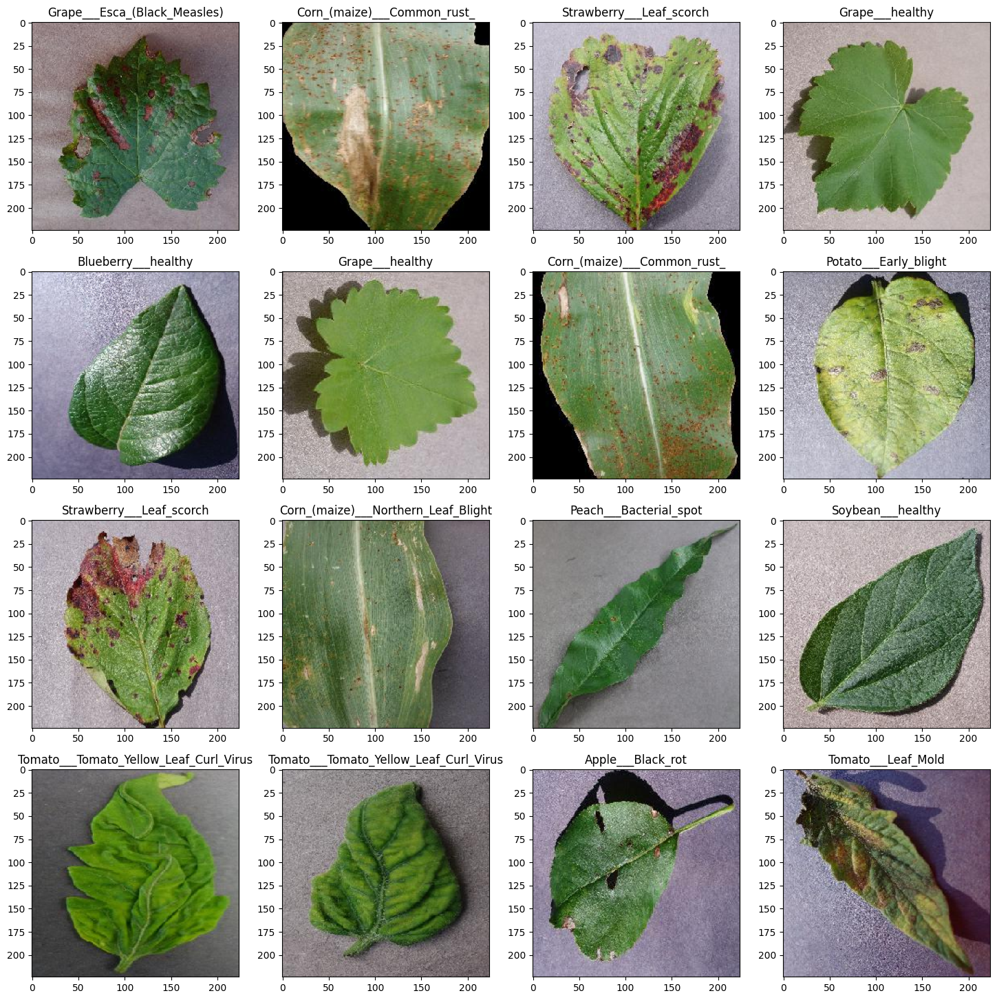

In [11]:
#getting the class name and displaying 16 images and its class name
classes=list(training_data.class_indices.keys())
plt.figure(figsize=(18,18))
for X_batch, y_batch in training_data:
    
    for i in range(0,16):
        plt.subplot(4,4,i+1)
        plt.imshow(X_batch[i])
        plt.title(classes[np.where(y_batch[i]==1)[0][0]])
    # show the plot
    plt.show()
   # plt.savefig('rnd.jpg', bbox_inches = 'tight')
    break

In [12]:
#Finding Number of Uniqe plantes in the dataset
plants = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
    if plant.split('___')[1] != 'healthy':
        NumberOfDiseases += 1
print(f"Unique Plants are: \n{plants}\n")
# displayig number of unique diseases
print("Number of diseases are: {}".format(NumberOfDiseases))

Unique Plants are: 
['Apple', 'Blueberry', 'Cherry_(including_sour)', 'Corn_(maize)', 'Grape', 'Orange', 'Peach', 'Pepper,_bell', 'Potato', 'Raspberry', 'Soybean', 'Squash', 'Strawberry', 'Tomato']

Number of diseases are: 26


In [13]:
# Number of images for each disease
nums_train = {}
nums_val = {}
for disease in diseases:
    nums_train[disease] = len(os.listdir(train_path + '/' + disease))
    nums_val[disease] = len(os.listdir(valid_path + '/' + disease))
img_per_class_train = pd.DataFrame(nums_train.values(), index=nums_train.keys(), columns=["no. of images"])
print('Train datast distribution :')
img_per_class_train

Train datast distribution :


,no. of images
Apple___Apple_scab,2016
Apple___Black_rot,1987
Apple___Cedar_apple_rust,1760
Apple___healthy,2008
Blueberry___healthy,1816
Cherry_(including_sour)___healthy,1826
Cherry_(including_sour)___Powdery_mildew,1683
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot,1642
Corn_(maize)___Common_rust_,1907
Corn_(maize)___healthy,1859


Text(0.5, 1.0, 'Images per each class of plant disease')

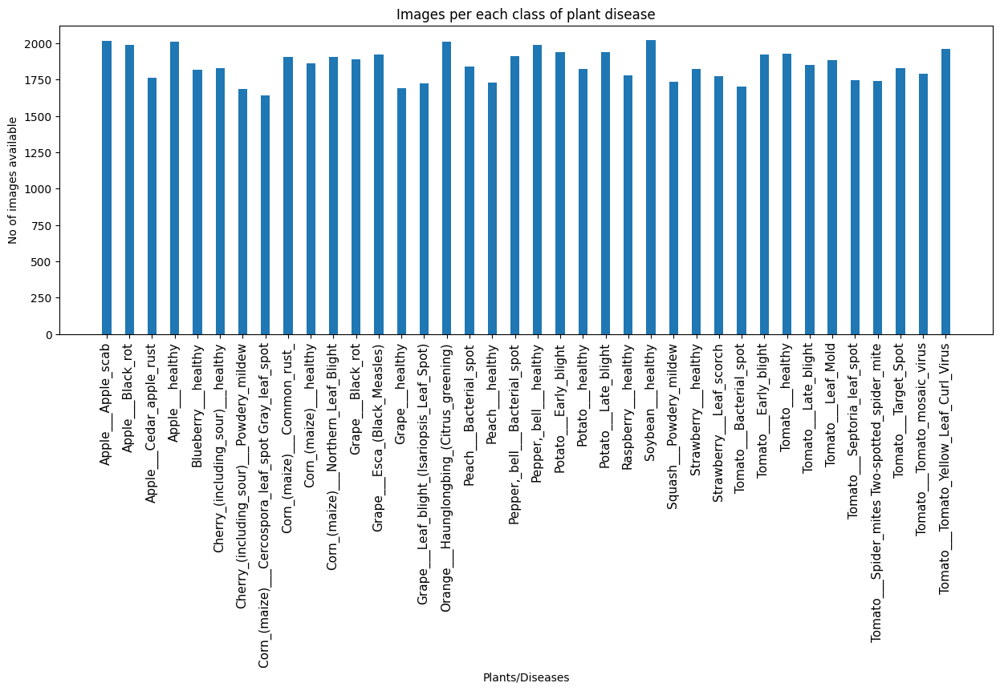

In [22]:
# section for visualising each class in the training raw dataset
train_diratory=train_path
nums = {}
for disease in diseases:
    nums[disease] = len(os.listdir(train_path + '/' + disease))

# plotting number of images available for each image classes
index = [n for n in range(38)]
plt.figure(figsize=(15, 5))
plt.bar(index, [n for n in nums.values()], width=0.4)
plt.xlabel('Plants/Diseases', fontsize=10)
plt.ylabel('No of images available', fontsize=10)
plt.xticks(index, diseases, fontsize=11, rotation=90)
plt.title('Images per each class of plant disease')

In [23]:
#Custom Model here
def define_custom_model():
  custom_model = keras.Sequential()
  custom_model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))

  custom_model.add(BatchNormalization()) # Adding  Batch normalizitoan #

  custom_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(256, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(256, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(512, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((3, 3)))

  custom_model.add(layers.Flatten())
  custom_model.add(layers.Dropout(0.5))
  custom_model.add(Flatten())
  custom_model.add(Dense(1024,activation='relu'))
  custom_model.add(layers.Dense((38), activation='softmax'))

  return custom_model
################################################################################

In [24]:
###############################################################################
#Setting up differt custome  models  here
model = define_custom_model()  # setting the model -5 
################################################################################

In [25]:
################################################################################
#Model compiling  
opt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy',metrics=['accuracy'])
################################################################################

In [26]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 111, 111, 32)      0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 batch_normalization_1 (Bat  (None, 54, 54, 64)        256       
 chNormalization)                                                
                                                      

In [27]:
import keras.callbacks as callbacks
import time
early_stopping_cb = callbacks.EarlyStopping(monitor="loss", patience=3)

In [18]:
start_training = perf_counter() 
history = model.fit(
    training_data, 
    validation_data = validation_data,
    epochs = 12, batch_size = 50,
    callbacks=[early_stopping_cb]
)
end_training= perf_counter() 

Epoch 1/12
1406/1406 [==============================] - 5040s 4s/step - loss: 1.4889 - accuracy: 0.5570 - val_loss: 0.6206 - val_accuracy: 0.8014
Epoch 2/12
1406/1406 [==============================] - 4570s 3s/step - loss: 0.5534 - accuracy: 0.8248 - val_loss: 0.3199 - val_accuracy: 0.9004
Epoch 3/12
1406/1406 [==============================] - 4795s 3s/step - loss: 0.3504 - accuracy: 0.8855 - val_loss: 0.1922 - val_accuracy: 0.9380
Epoch 4/12
1406/1406 [==============================] - 4542s 3s/step - loss: 0.2562 - accuracy: 0.9165 - val_loss: 0.1475 - val_accuracy: 0.9525
Epoch 5/12
1406/1406 [==============================] - 4571s 3s/step - loss: 0.2023 - accuracy: 0.9338 - val_loss: 0.1584 - val_accuracy: 0.9493
Epoch 6/12
1406/1406 [==============================] - 4570s 3s/step - loss: 0.1622 - accuracy: 0.9464 - val_loss: 0.1790 - val_accuracy: 0.9388
Epoch 7/12
1406/1406 [==============================] - 4543s 3s/step - loss: 0.1333 - accuracy: 0.9548 - val_loss: 0.1019 -

In [29]:
def Display_Model_Loss_Accuracy(history):
  # funtion for ploting model accuracy and loss graph
  #=============================================================================
  # Create figure with secondary y-axis
  fig = make_subplots(specs=[[{"secondary_y": True}]])

  # Adding traces ------------------------------------------------------------
  fig.add_trace(go_obj.Scatter( y=history.history['val_loss'], name="val_loss"),secondary_y=False,)
  fig.add_trace(go_obj.Scatter( y=history.history['loss'], name="loss"),secondary_y=False,)
  fig.add_trace(go_obj.Scatter( y=history.history['val_accuracy'], name="val accuracy"),secondary_y=True,)
  fig.add_trace(go_obj.Scatter( y=history.history['accuracy'], name="accuracy"),secondary_y=True,)

  # Adding figure title---------------------------------------------------------
  fig.update_layout(title_text="Loss/Accuracy of Final Model")
  # Set x-axis title
  fig.update_xaxes(title_text="Epoch")

  # Set y-axes titles-----------------------------------------------------------
  fig.update_yaxes(title_text="<b>primary</b> Loss", secondary_y=False)
  fig.update_yaxes(title_text="<b>secondary</b> Accuracy", secondary_y=True)
  fig.show()
  #============================================================================

In [38]:
Display_Model_Loss_Accuracy(history) # calling funciton to print model accuracy graph

NameError: name 'history' is not defined

In [2]:
################################################################################
def validate_test_images_and_display(model,number_test_images):
  #funtion for prediting the 33 supplied test image's file name and predicted class
  test_image_data = []
  test_image_filenames = []
  IMG_SHAPE  = (224, 224)
  #-----------------------------------------------------------------------------
  for img_name in os.listdir(test_path):
    img = load_img(os.path.join(test_path, img_name), target_size = IMG_SHAPE)
    test_image_data.append(img_to_array(img, dtype = 'uint8'))
    test_image_filenames.append(img_name)
      
  test_image_data = np.array(test_image_data)/255
  #print(f'\nTotal testing images: {len(test_image_data)}')
  #-----------------------------------------------------------------------------
  test_pred = np.argmax(model.predict(test_image_data), axis = 1)

  class_name_lookup = {name: index for index, name in training_data.class_indices.items()}
  #for k, v in class_name_lookup.items():
  #  print(f"{k:2} : {v}")
  
  test_pred_classes = [class_name_lookup[i] for i in test_pred]

  data_frame=pd.DataFrame({
    "Filename": test_image_filenames,
    "Predicted classes": test_pred_classes
    })
  display (data_frame) # Displaying the dataframe 
  #-----------------------------------------------------------------------------
  #Display test images and its real label and predecited label here
  plt.subplots(nrows = 3, ncols = 4, figsize = (20, 15))

  for i in range(number_test_images):
    plt.subplot(3, 4, i + 1)
    plt.axis(False)
    plt.grid(False)
    plt.imshow(test_image_data[i])
    plt.title(f"True: {test_image_filenames[i][:-4]}\nPrediction:{test_pred_classes[i]}")
  plt.show()
  #-----------------------------------------------------------------------------
################################################################################

In [33]:

number_test_images=12 # printing 12 images from the supplied test images
validate_test_images_and_display(model,number_test_images) # Prediting the supplied 33 images which is unkonw to the model

PermissionError: [Errno 13] Permission denied: 'D:\\Plantdiseasedetection\\test\\test'

In [66]:
class_name_lookup = {name: index for index, name in training_data.class_indices.items()}

In [67]:
#For confusion matrix
val_true = validation_data.classes
val_pred = np.argmax(model.predict(validation_data), axis = 1)
val_pred_float=model.predict(validation_data)
class_name_lookup = {name: index for index, name in training_data.class_indices.items()}

352/352 [==============================] - 270s 766ms/step


In [72]:
################################################################################
#Fuction to dispay confusion matrix based on the predections.
def Display_Confusion_Matrix(val_true,val_pred,class_name_lookup):
  # here printing the confustion matrix
  _, ax = plt.subplots(figsize = (20, 16))
  ax.grid(False)

  ConfusionMatrixDisplay(confusion_matrix(val_true, val_pred, labels = list(class_name_lookup.keys())),
                        display_labels = list(class_name_lookup.values())
                        ).plot(ax = ax, xticks_rotation = 'vertical')

  plt.savefig('confusion_matrix.jpg', bbox_inches = 'tight')
  plt.show()
################################################################################

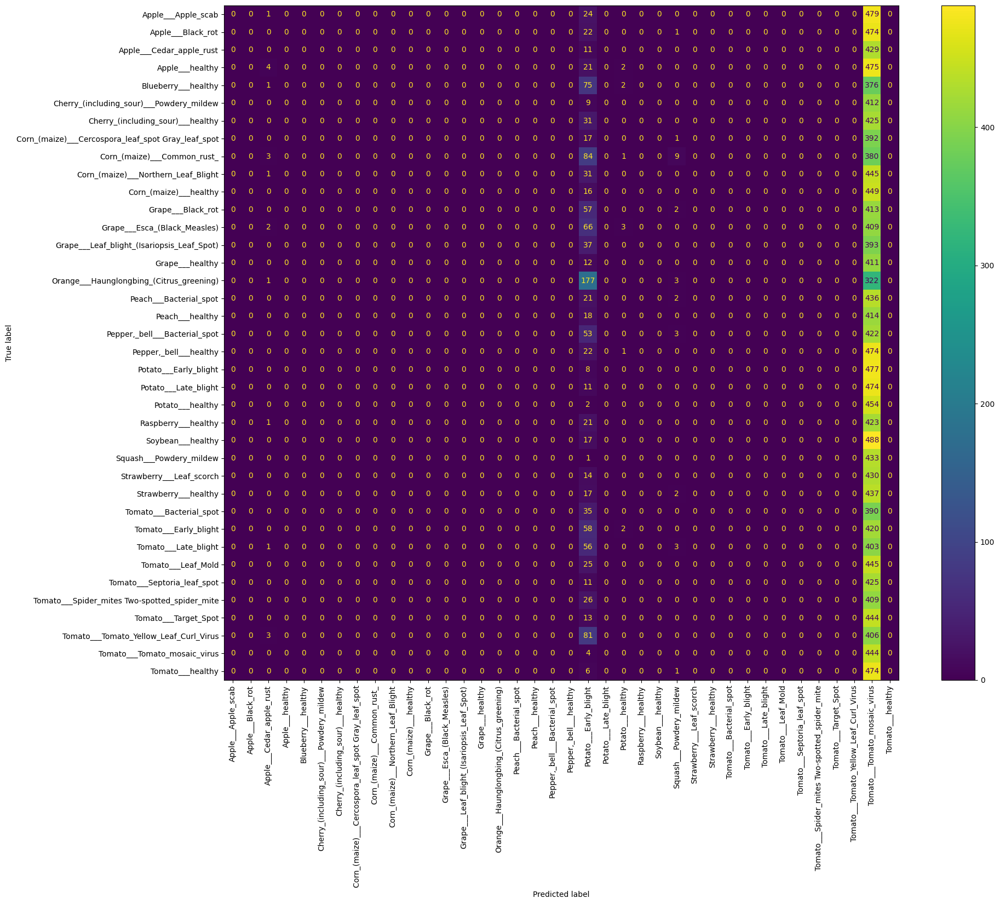

In [73]:
Display_Confusion_Matrix(val_true,val_pred,class_name_lookup) # confusion-matrix

In [42]:
def Dispay_Classifiation_Report(val_true,val_pred,class_name_lookup):
################################################################################
# classifiation report printing here
  display_labels = list(class_name_lookup.values())
  print(classification_report(val_true,val_pred,target_names=class_name_lookup.values())) 
################################################################################

In [43]:
Dispay_Classifiation_Report(val_true,val_pred,class_name_lookup)

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.99      0.95      0.97       504
                                 Apple___Black_rot       1.00      0.99      0.99       497
                          Apple___Cedar_apple_rust       0.98      0.96      0.97       440
                                   Apple___healthy       0.95      0.99      0.97       502
                               Blueberry___healthy       0.97      0.98      0.98       454
          Cherry_(including_sour)___Powdery_mildew       1.00      1.00      1.00       421
                 Cherry_(including_sour)___healthy       0.99      0.97      0.98       456
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.95      0.94      0.94       410
                       Corn_(maize)___Common_rust_       1.00      0.99      0.99       477
               Corn_(maize)___Northern_Leaf_Blight       0.95      0.97      0.

In [44]:
target=validation_data.class_indices.keys() # getting the classs names for printing the ROC Graph
y_test =  validation_data.classes

In [46]:
################################################################################
# function  roc auc score for multi-class datasets, since this dataset has 38 class
# funtion calling 2 times
def Multiclass_Roc_Auc_Scores(y_test, y_pred,min_class,max_class, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    i=0
    for (idx, c_label) in enumerate(target):
          i=i+1
          fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
          if i>=min_class and i<=max_class: 
            c_ax.plot(fpr, tpr, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
    c_ax.plot(fpr, fpr, 'b-', label = 'Random Guessing')
    return roc_auc_score(y_test, y_pred, average=average)

ROC AUC score: 0.9824968938483327


Text(0, 0.5, 'True Positive Rate')

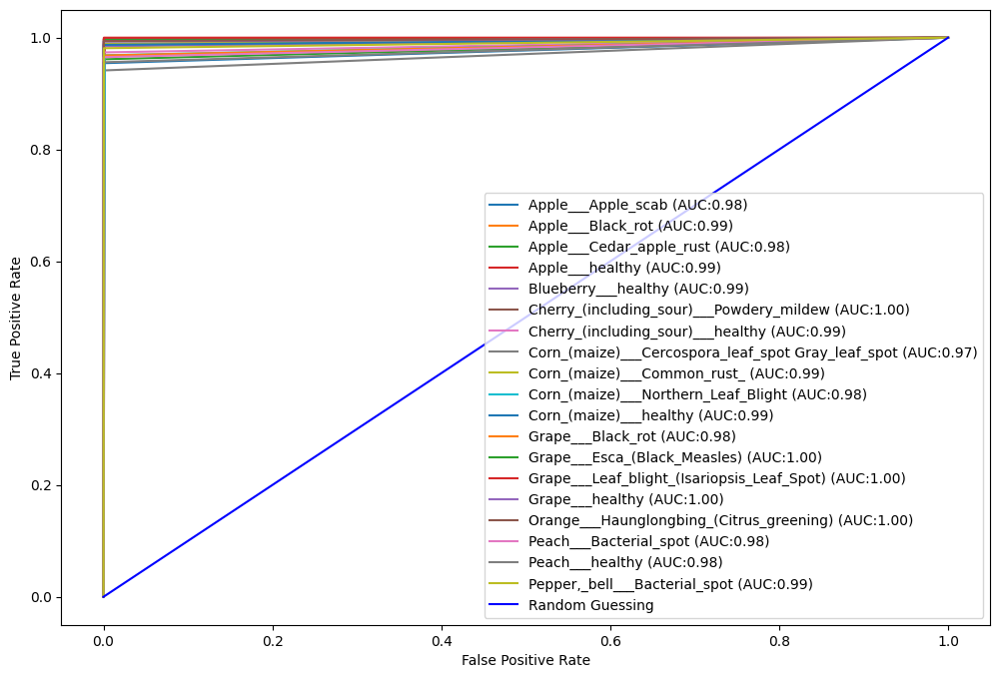

In [47]:
################################################################################
#Printing ROC curve for the class 1-19 here
fig, c_ax = plt.subplots(1,1, figsize = (12, 8))
print('ROC AUC score:', Multiclass_Roc_Auc_Scores(y_test, val_pred,1,19))
c_ax.legend()
c_ax.set_xlabel('False Positive Rate')
c_ax.set_ylabel('True Positive Rate')

In [48]:
model.save('final_model.h5') # saving the Model here, so that re-use the model later

c:\users\manoranjan\appdata\local\programs\python\python38\lib\site-packages\keras\src\engine\training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [49]:
def model_evalution(ev_model,value_data,model_size):
    ################################################################################
    #Model evalution : # Getting  validation accuracy and model size time to train
    ################################################################################
    start = perf_counter() 
    loss,Model_Accuracy = ev_model.evaluate(value_data, verbose = 0 )
    end = perf_counter() 
    ModelSize = model_size
    # let convert to MB
    ModelSize = ModelSize / (1024 * 1024)
    #-------------------------------------------------------------------------------
    print('Model Summary:')
    print('Model size(MB)                : {}'.format(ModelSize))
    print('Time on Validation data (sec) : {}'.format(end - start))
    print('Accuracy on validation data   : {}'.format(Model_Accuracy))
    print('Loss on validation data       : {}'.format(loss))
    #print('Time on Training Model  (sec) : {}'.format(end_training - start_training)

In [51]:
model_evalution(model,validation_data,os.path.getsize('final_model.h5'))

Model Summary:
Model size(MB)                : 31.24981689453125
Time on Validation data (sec) : 262.3946498000005
Accuracy on validation data   : 0.965627133846283
Loss on validation data       : 0.10590687394142151


In [52]:
## *** InceptionV3 **###
#Import the InceptionV3 library as shown below and
#add preprocessing layer to the front of InceptionV3
from tensorflow.keras.applications.inception_v3 import InceptionV3
#-------------------------------------------------------------------------------
inception = InceptionV3(input_shape=(224,224,3), weights='imagenet', include_top=False)
print("*** Building model with InceptionV3 with imagenet weights***")
model_inception = Sequential([
    inception,
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(rate=0.2),
    Dense(38, activation='softmax')
])

87910968/87910968 [==============================] - 112s 1us/step
*** Building model with InceptionV3 with imagenet weights***


In [53]:
######################################################################################
#Setting the same model name here, so all the functions will work without out any chage
model = model_inception #setting Inception model here
######################################################################################

In [54]:
################################################################################
#Model compiling
opt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy',metrics=['accuracy'])
################################################################################

In [32]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

In [56]:
model=tf.keras.models.load_model('trained_model.keras')

In [57]:
!pip install opencv-python

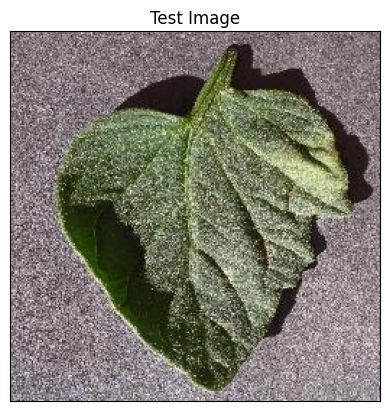

In [59]:
import cv2
image_path="test/test/TomatoHealthy1.JPG"
#reading image
img=cv2.imread(image_path)
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB) #convert bgr image to rgb
#displaying image
plt.imshow(img)
plt.title("Test Image")
plt.xticks([])
plt.yticks([])
plt.show()

Found 33 images in test/test


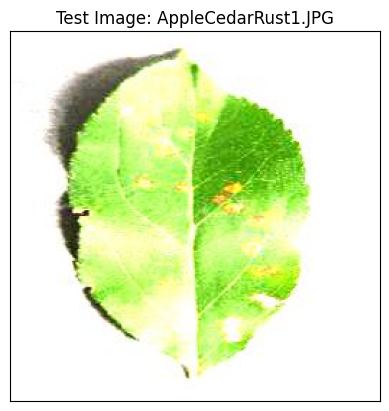

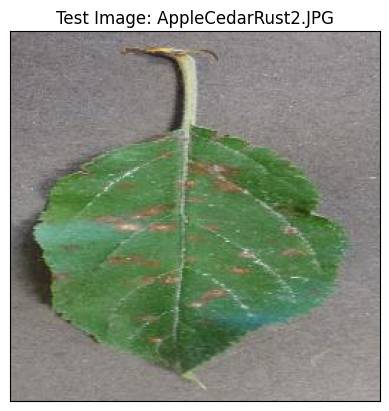

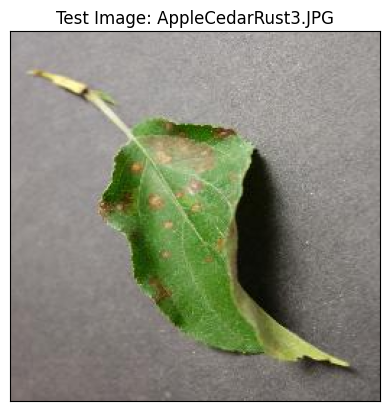

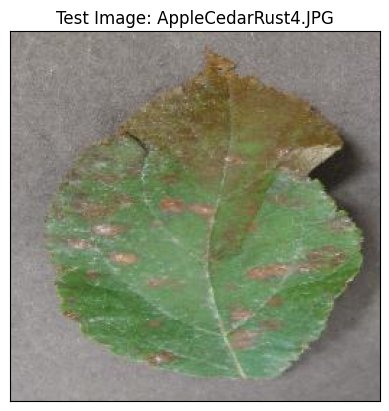

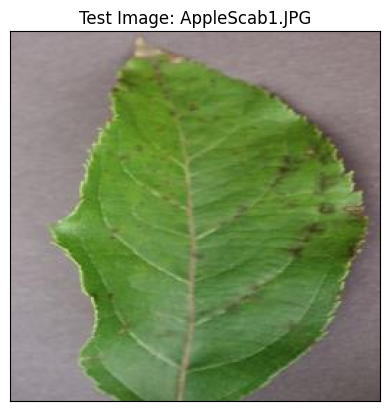

...

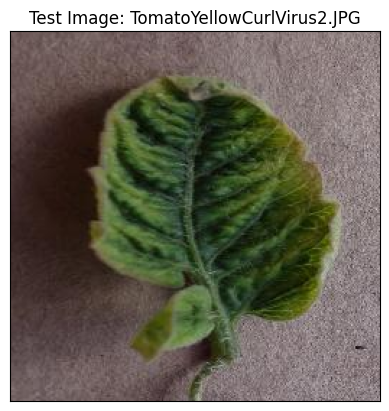

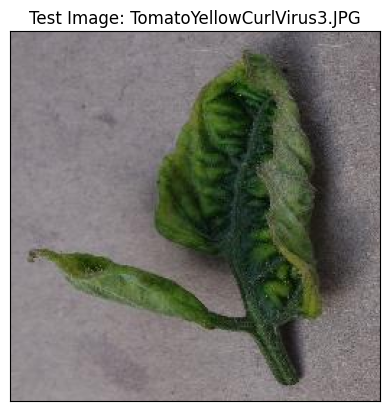

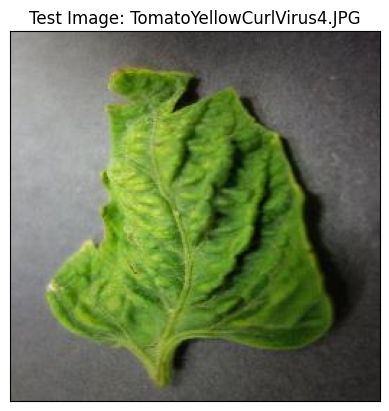

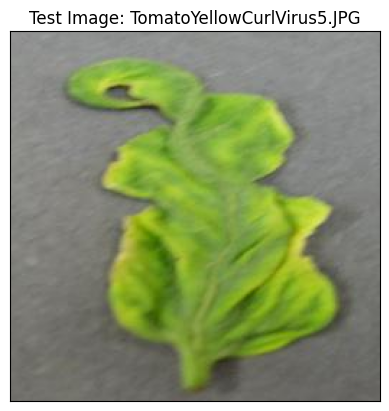

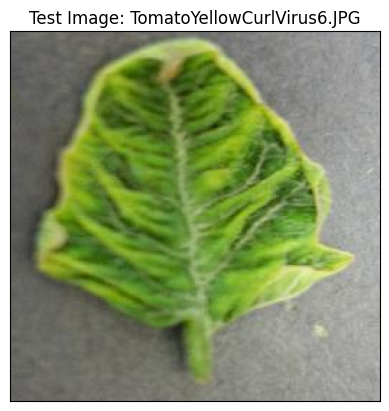

In [60]:
import os
import cv2
import matplotlib.pyplot as plt

def display_all_test_images(test_folder):
    # Get all image filenames
    image_files = [f for f in os.listdir(test_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

    print(f"Found {len(image_files)} images in {test_folder}")

    for image_file in image_files:
        image_path = os.path.join(test_folder, image_file)

        # Read image
        img = cv2.imread(image_path)
        if img is None:
            print(f"❌ Could not read {image_path}")
            continue

        # Convert BGR to RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Display
        plt.imshow(img)
        plt.title(f"Test Image: {image_file}")
        plt.xticks([])
        plt.yticks([])
        plt.show()

# Call the function
display_all_test_images('test/test')


In [61]:
image=tf.keras.preprocessing.image.load_img(image_path,target_size=(128,128))
input_arr=tf.keras.preprocessing.image.img_to_array(image)
input_arr=np.array([input_arr]) #convert single image to a batch
print(input_arr.shape)

(1, 128, 128, 3)


In [62]:
predictions=model.predict(input_arr)
predictions,predictions.shape

1/1 [==============================] - 0s 271ms/step


(array([[1.1475114e-16, 1.2630037e-17, 7.5700770e-17, 3.8232403e-12,
         1.4229947e-16, 4.5621964e-13, 8.4862982e-18, 8.5279622e-19,
         1.0985715e-20, 6.7220707e-21, 1.3243310e-21, 2.6558200e-22,
         4.4553607e-19, 2.4416585e-22, 4.7271147e-21, 1.7180550e-19,
         5.8257126e-19, 1.0778792e-18, 1.1874460e-18, 2.8310642e-16,
         2.1929553e-18, 7.7516834e-20, 1.7942167e-14, 1.4465653e-19,
         3.0502697e-16, 3.2702890e-13, 1.2206858e-16, 9.0380641e-18,
         1.1423821e-19, 2.4404624e-18, 8.9847908e-16, 6.3694726e-15,
         1.3265540e-16, 9.6250581e-15, 2.6370616e-08, 6.2649900e-21,
         6.9831120e-19, 1.0000000e+00]], dtype=float32),
 (1, 38))

In [63]:
result_index=np.argmax(predictions)
result_index

37

In [64]:
class_name=['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry_(including_sour)_Powdery_mildew',
 'Cherry_(including_sour)_healthy',
 'Corn_(maize)_Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)Common_rust',
 'Corn_(maize)_Northern_Leaf_Blight',
 'Corn_(maize)_healthy',
 'Grape___Black_rot',
 'Grape__Esca(Black_Measles)',
 'Grape__Leaf_blight(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange__Haunglongbing(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,bell__Bacterial_spot',
 'Pepper,bell__healthy',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___Target_Spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy']

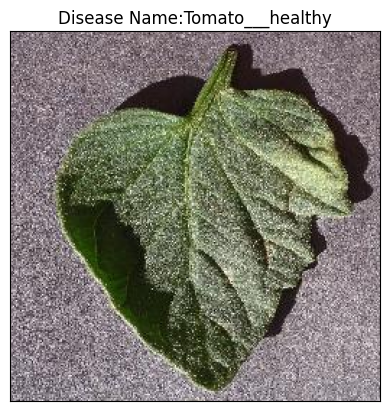

In [88]:
#displaying result of disease prediction
model_prediction=class_name[result_index]
plt.imshow(img)
plt.title(f"Disease Name:{model_prediction}")
plt.xticks([])
plt.yticks([])
plt.show()

In [90]:
print(model.input_shape)


(None, 128, 128, 3)


In [91]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def display_all_disease_predictions(model, test_path, class_name, number_test_images):
    image_files = os.listdir(test_path)[:number_test_images]

    for img_name in image_files:
        img_path = os.path.join(test_path, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Skipping invalid image: {img_name}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Resize to 128x128 as required by the model
        img_resized = cv2.resize(img, (128, 128))
        img_array = np.expand_dims(img_resized, axis=0) / 255.0

        # Predict
        prediction = model.predict(img_array)
        result_index = np.argmax(prediction)
        model_prediction = class_name[result_index]

        # Display
        plt.imshow(img)
        plt.title(f"Disease: {model_prediction}")
        plt.axis('off')
        plt.show()



Skipping invalid image: .ipynb_checkpoints
1/1 [==============================] - 0s 58ms/step


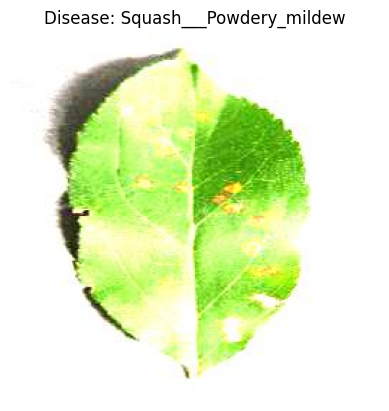

1/1 [==============================] - 0s 45ms/step


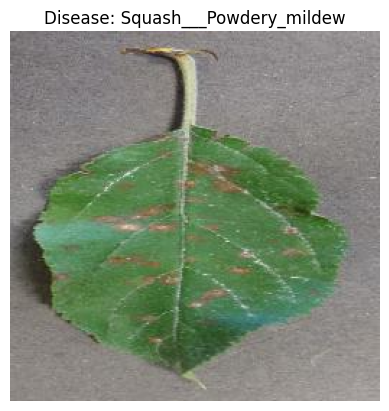

1/1 [==============================] - 0s 40ms/step


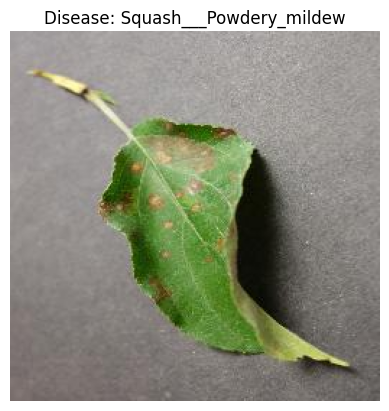

1/1 [==============================] - 0s 45ms/step


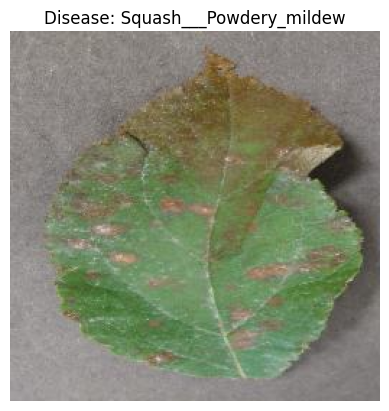

1/1 [==============================] - 0s 41ms/step


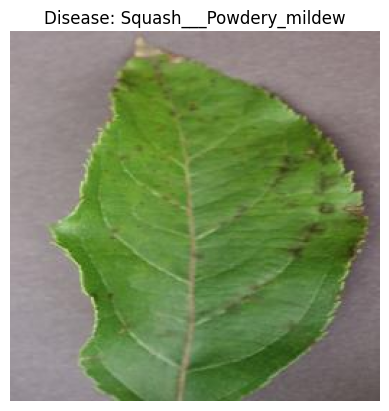

1/1 [==============================] - 0s 44ms/step


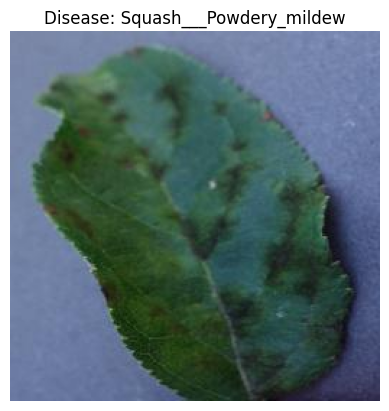

1/1 [==============================] - 0s 32ms/step


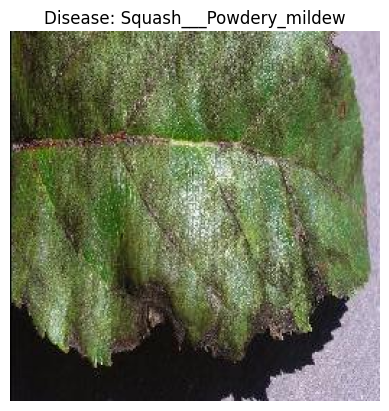

1/1 [==============================] - 0s 34ms/step


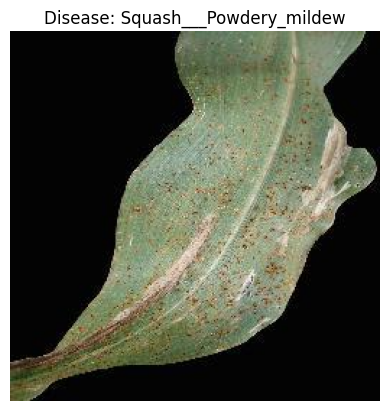

1/1 [==============================] - 0s 47ms/step


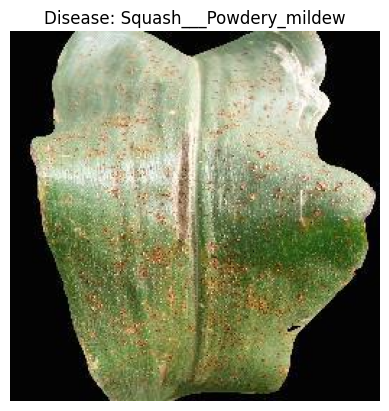

1/1 [==============================] - 0s 36ms/step


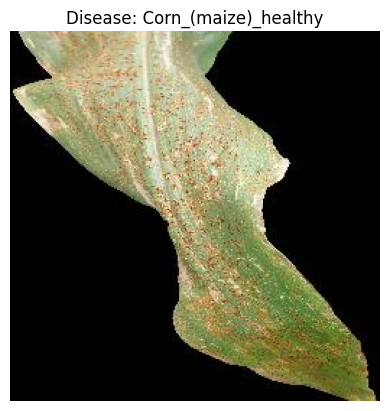

1/1 [==============================] - 0s 39ms/step


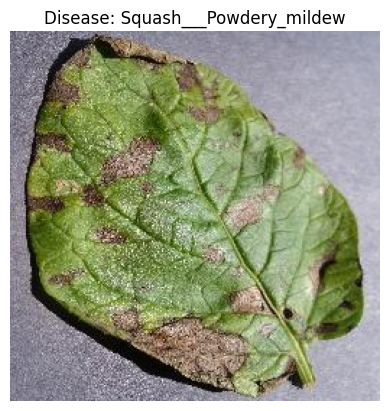

1/1 [==============================] - 0s 39ms/step


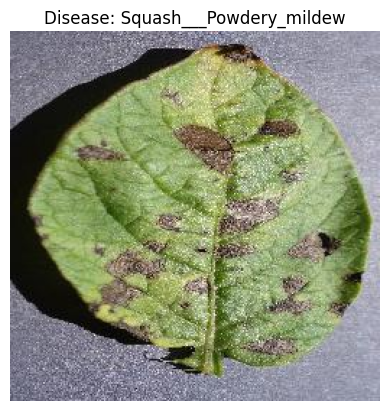

1/1 [==============================] - 0s 31ms/step


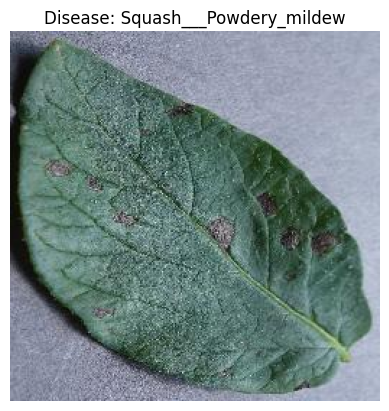

1/1 [==============================] - 0s 70ms/step


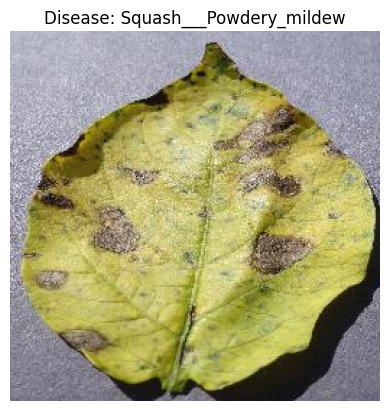

1/1 [==============================] - 0s 42ms/step


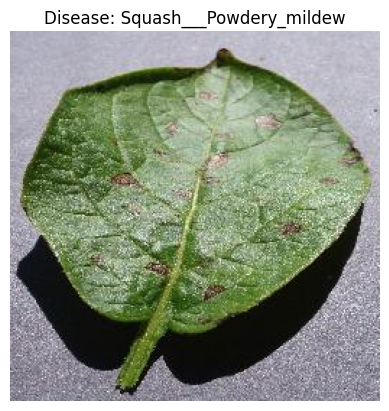

1/1 [==============================] - 0s 48ms/step


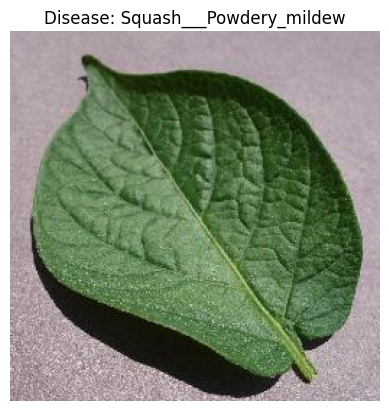

1/1 [==============================] - 0s 41ms/step


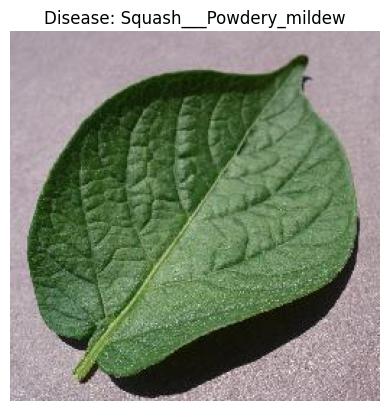

1/1 [==============================] - 0s 89ms/step


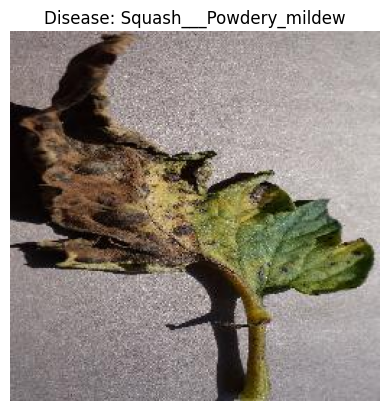

1/1 [==============================] - 0s 60ms/step


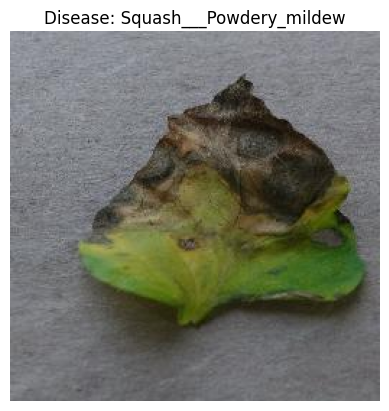

1/1 [==============================] - 0s 46ms/step


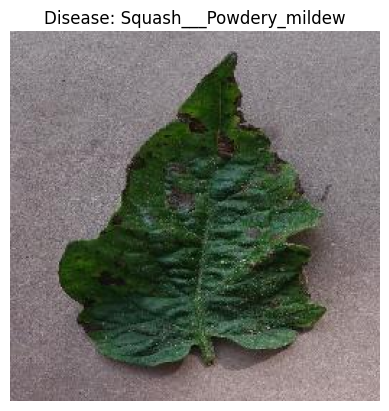

1/1 [==============================] - 0s 38ms/step


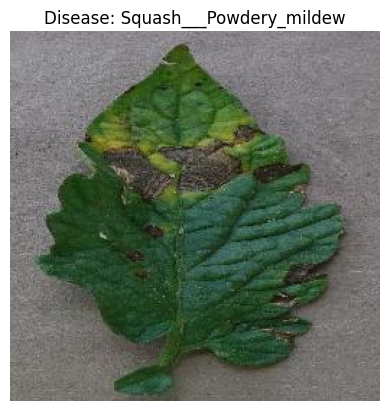

1/1 [==============================] - 0s 38ms/step


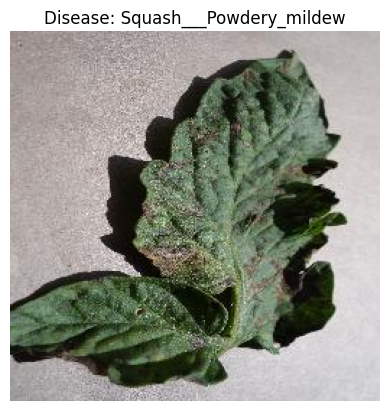

1/1 [==============================] - 0s 37ms/step


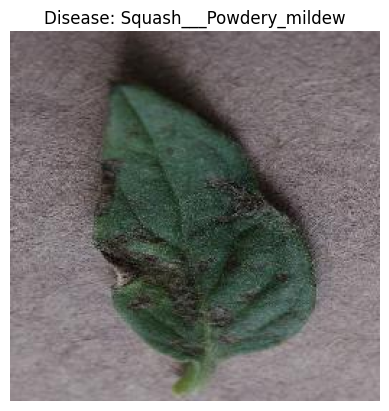

1/1 [==============================] - 0s 56ms/step


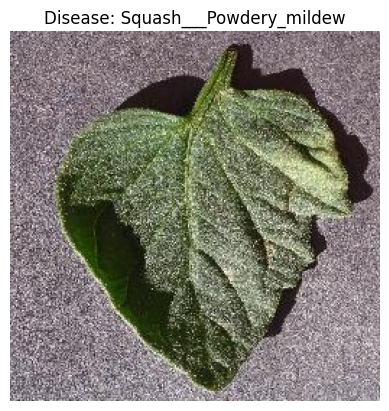

1/1 [==============================] - 0s 59ms/step


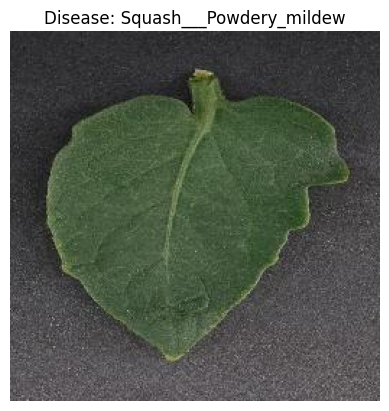

1/1 [==============================] - 0s 50ms/step


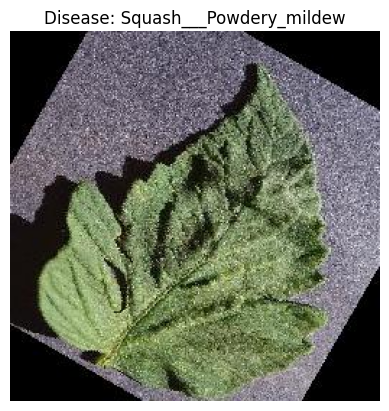

1/1 [==============================] - 0s 64ms/step


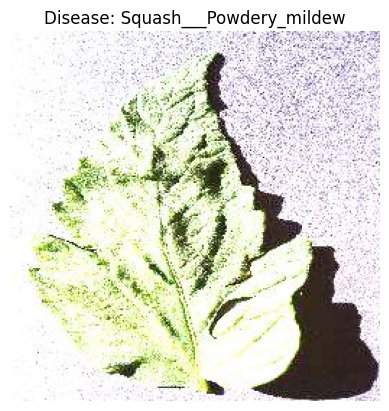

1/1 [==============================] - 0s 55ms/step


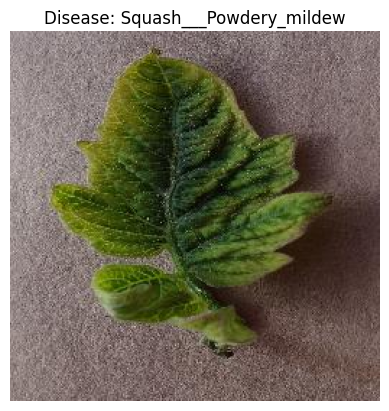

1/1 [==============================] - 0s 83ms/step


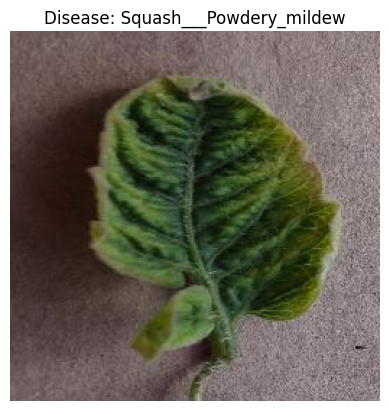

1/1 [==============================] - 0s 49ms/step


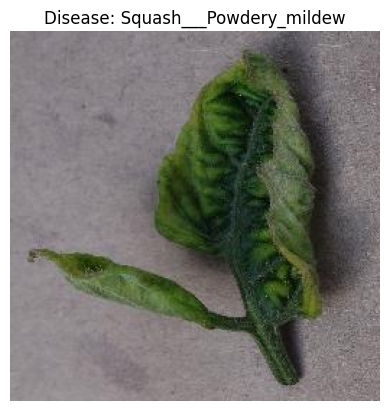

1/1 [==============================] - 0s 34ms/step


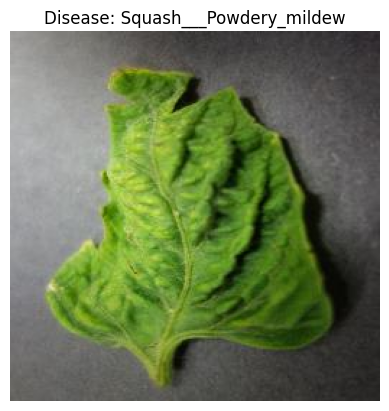

1/1 [==============================] - 0s 50ms/step


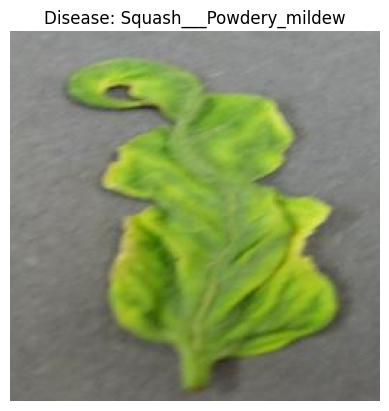

In [94]:
test_path = "test/test"  # Update path if needed
class_name=['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry_(including_sour)_Powdery_mildew',
 'Cherry_(including_sour)_healthy',
 'Corn_(maize)_Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)Common_rust',
 'Corn_(maize)_Northern_Leaf_Blight',
 'Corn_(maize)_healthy',
 'Grape___Black_rot',
 'Grape__Esca(Black_Measles)',
 'Grape__Leaf_blight(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange__Haunglongbing(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,bell__Bacterial_spot',
 'Pepper,bell__healthy',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___Target_Spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy']
number_test_images = 33

display_all_disease_predictions(model, test_path, class_name, number_test_images)
